# Credit Card Fraud Detection

__Goal:__ 

Predict the probability of an online credit card transaction being fraudulent, based on different properties of the transactions. 


## 1. Setup Environment

The goal of this section is to:
- Import all the packages
- Set the options for data visualizations

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')

other dataset: 
https://www.openml.org/search?type=data&status=active&id=45036&sort=runs


In [25]:
# Data Manipulation
import numpy as np 
import pandas as pd 

# Data Visualization
import seaborn as sns 
import matplotlib.pyplot as plt
import matplotlib.lines as mlines

# Time
import time
import datetime

# Machine Learning
from sklearn.preprocessing import LabelEncoder, minmax_scale
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, GridSearchCV
# some changes to sklearm packages
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, roc_auc_score, roc_curve, precision_recall_curve, precision_score
from sklearn.calibration import calibration_curve
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import minmax_scale

from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

# imbalanced learning (more on this later)
from imblearn.over_sampling import RandomOverSampler
from scipy.stats import chi2_contingency,  f_oneway

import gc
import warnings
from tqdm import tqdm

# Set Options
pd.set_option('display.max_rows', 800)
pd.set_option('display.max_columns', 500)
%matplotlib inline
warnings.filterwarnings("ignore")

Upload the zip file into the left column. Then unzip it;

Good practice to use zip files to speed things up. Also Colab is not run on your own environment (local computer). 

When you do command line, be sure that you specify "!"

In [30]:
!unzip /dataset.parquet.zip

Archive:  /dataset.parquet.zip
  inflating: dataset.parquet         
  inflating: __MACOSX/._dataset.parquet  


## 2. Data Overview

Purpose is to:

1. Load the dataset
2. Explore the features

**Note:** Not all transactions have corresponding identity information.

Load the transaction and identity datasets using pd.read_csv(), but for the sake of time, we use pd.read_parquet().

Whenever you have a data file with more than a few thousand rows, don't use pd.read_csv(); too slow and kills progress

In [33]:
%%time
# Load Data
"""
df = pd.read_csv('/content/creditcard.csv')
df.to_parquet('/content/dataset.parquet') 
"""
# save time (b/c csv is very slow)

# load into the left side with the parquet file 
df = pd.read_parquet('dataset.parquet')
df.head()

CPU times: user 5.17 s, sys: 2.28 s, total: 7.45 s
Wall time: 922 ms


,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,None,None,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,None,None,None,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,NaN,None,None,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,NaN,NaN,None,None,None,None,None,NaN,None,None,None,None,None,None,None,None
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,None,1.0,1.

In [34]:
# add the parquet file

#df = pd.read_parquet("/content/credit.parquet")

In [35]:
# Identitiy Data
df.head(10) # 10 rows

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,None,None,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,None,None,None,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,NaN,None,None,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,NaN,NaN,None,None,None,None,None,NaN,None,None,None,None,None,None,None,None
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,None,1.0,1.

Shape of data

In [36]:
print(df.shape)

(590540, 434)


Whenever you use a package / library, have to install first 

!pip install --upgrade package_name

In [37]:
'''!pip install pandas_summary'''

'!pip install pandas_summary'

In [38]:
'''from pandas_summary import DataFrameSummary


df_summary = DataFrameSummary(df)
df_summary.summary()
'''

'from pandas_summary import DataFrameSummary\n\n\ndf_summary = DataFrameSummary(df)\ndf_summary.summary()\n'

The above took a real long time! But, it still might be more efficient than writing a for-loop to do things step by step

In [39]:
# Reduce memory usage
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage(deep=True).sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)    
    end_mem = df.memory_usage(deep=True).sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

In [40]:
df = reduce_mem_usage(df)

Mem. usage decreased to 1175.65 Mb (52.7% reduction)


All numeric columns, meaning we don't need to do anything with text data

Get a sense of the distribution of target variable

In [41]:
df.loc[:, 'isFraud'].value_counts()
# this is to see how many are each class 

0    569877
1     20663
Name: isFraud, dtype: int64

Arrange things more nicely

In [42]:
class_distrib = pd.DataFrame(df.isFraud.value_counts().reset_index()) # use df["col_name"] or df.col_name to refer to a specific column
# the .reset_index() is needed to make the format nice; otherwise, it's just a mess and columns don't line up
class_distrib.columns = ['class', "count"]
class_distrib

,class,count
0,0,569877
1,1,20663


In [43]:
# Drop the columns where one category contains more than 90% values
drop_cols = [] # list data structure

# create a for-loop to run through
for col in df.columns: 
    missing_share = df[col].isnull().sum()/df.shape[0]
    if missing_share > 0.9:
        drop_cols.append(col)
        print(col)
        # df[col + "_missing_flag"] = df[col].isnull()
    
good_cols = [col for col in df.columns if col not in drop_cols] # don't want to drop / or keep

dist2
D7
id_07
id_08
id_18
id_21
id_22
id_23
id_24
id_25
id_26
id_27


An idea: maybe it's good to have some functions in place for future reference. We will define a function now as follows:

In [44]:
"""
def my_function(param 1, ..., param n):

  # write your function. 
  # Tips: start with some basic structures like lists or dictionaries or some numbers (usually empty or set to 0) 
  # which you will update in a loop or more loops and then return it

  # initalize some variable 
  # (ie) x = 0

  # for i in range(len()) or some_number or df.columns or df.col_name:
    # do something

  # return that variable
"""

'\ndef my_function(param 1, ..., param n):\n\n  # write your function. \n  # Tips: start with some basic structures like lists or dictionaries or some numbers (usually empty or set to 0) \n  # which you will update in a loop or more loops and then return it\n\n  # initalize some variable \n  # (ie) x = 0\n\n  # for i in range(len()) or some_number or df.columns or df.col_name:\n    # do something\n\n  # return that variable\n'

In [45]:
def drop_cols_with_much_missing_values(df):
  drop_cols = [] # list data structure
  # create a for-loop to run through
  for col in df.columns: 
      missing_share = df[col].isnull().sum()/df.shape[0]
      if missing_share > 0.9:
          drop_cols.append(col)
          print(col)
          # df[col + "_missing_flag"] = df[col].isnull()
  good_cols = [col for col in df.columns if col not in drop_cols] # list comprehension [i for i in sth if <condition> else <sth>]
  return good_cols # return sth

In [46]:
good_cols = drop_cols_with_much_missing_values(df)
print(f"here are the good_cols: {good_cols}")
print(f'# of good_cols: {len(good_cols)}')

dist2
D7
id_07
id_08
id_18
id_21
id_22
id_23
id_24
id_25
id_26
id_27
here are the good_cols: ['TransactionID', 'isFraud', 'TransactionDT', 'TransactionAmt', 'ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'dist1', 'P_emaildomain', 'R_emaildomain', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', '

In [205]:
new_df = df[good_cols]

In [48]:
new_df.isnull().sum()

TransactionID          0
isFraud                0
TransactionDT          0
TransactionAmt         0
ProductCD              0
card1                  0
card2               8933
card3               1565
card4               1577
card5               4259
card6               1571
addr1              65706
addr2              65706
dist1             352271
P_emaildomain      94456
R_emaildomain     453249
C1                     0
C2                     0
C3                     0
C4                     0
C5                     0
C6                     0
C7                     0
C8                     0
C9                     0
C10                    0
C11                    0
C12                    0
C13                    0
C14                    0
D1                  1269
D2                280797
D3                262878
D4                168922
D5                309841
D6                517353
D8                515614
D9                515614
D10                76022
D11               279287


In [49]:
new_df.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,None,None,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,None,None,None,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN,NaN,None,None,NaN,NaN,NaN,None,None,None,None,NaN,None,None,None,None,None,None,None,None
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,gmail.com,None,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,None,None,None,M0

In [50]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 590540 entries, 0 to 590539
Columns: 422 entries, TransactionID to DeviceInfo
dtypes: float16(344), float32(45), int16(1), int32(2), int8(1), object(29)
memory usage: 630.2+ MB


In [52]:
# create length for
categorical_col = [col for col in new_df.columns if new_df[col].dtype == 'object']
numeric_col = [col for col in new_df.columns if col not in categorical_col]
print(len(categorical_col))
print(len(numeric_col))

29
393


In [53]:
# 
for col in numeric_col:
  new_df[col] = new_df[col].astype('float64')
print(new_df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 590540 entries, 0 to 590539
Columns: 422 entries, TransactionID to DeviceInfo
dtypes: float64(393), object(29)
memory usage: 1.9+ GB
None


In [54]:
new_df.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_13,id_14,id_17,id_19,id_20,id_32
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.000000,588975.000000,586281.000000,524834.000000,524834.000000,238269.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,589271.000000,309743.000000,327662.000000,421618.000000,280699.000000,73187.000000,74926.000000,74926.000000,514518.000000,311253.000000,64717.000000,61952.000000,62187.000000,501427.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,514467.000000,421571.000000,421571.000000,421571.000000,421571.00000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,421571.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,513444.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,501376.000000,590226.000000,590226.00000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000000,590226.000

In [64]:
categorical_col

['ProductCD',
 'card4',
 'card6',
 'P_emaildomain',
 'R_emaildomain',
 'M1',
 'M2',
 'M3',
 'M4',
 'M5',
 'M6',
 'M7',
 'M8',
 'M9',
 'id_12',
 'id_15',
 'id_16',
 'id_28',
 'id_29',
 'id_30',
 'id_31',
 'id_33',
 'id_34',
 'id_35',
 'id_36',
 'id_37',
 'id_38',
 'DeviceType',
 'DeviceInfo']

In [85]:
for col in categorical_col:
    print(new_df[col].value_counts().head(10))
    print(f'# of categories: {len(new_df[col].value_counts())}')
    print('-------------------------------------------')

W    439670
C     68519
R     37699
H     33024
S     11628
Name: ProductCD, dtype: int64
# of categories: 5
-------------------------------------------
visa                384767
mastercard          189217
american express      8328
discover              6651
Name: card4, dtype: int64
# of categories: 4
-------------------------------------------
debit              439938
credit             148986
debit or credit        30
charge card            15
Name: card6, dtype: int64
# of categories: 4
-------------------------------------------
gmail.com        228355
yahoo.com        100934
hotmail.com       45250
anonymous.com     36998
aol.com           28289
comcast.net        7888
icloud.com         6267
outlook.com        5096
msn.com            4092
att.net            4033
Name: P_emaildomain, dtype: int64
# of categories: 59
-------------------------------------------
gmail.com        57147
hotmail.com      27509
anonymous.com    20529
yahoo.com        11842
aol.com           3701
outl

In [86]:
new_df['card1']

0         13926.0
1          2755.0
2          4663.0
3         18132.0
4          4497.0
           ...   
590535     6550.0
590536    10444.0
590537    12037.0
590538     7826.0
590539    15066.0
Name: card1, Length: 590540, dtype: float64

### Basic Visualizations on the distribution

<AxesSubplot:xlabel='class', ylabel='count'>

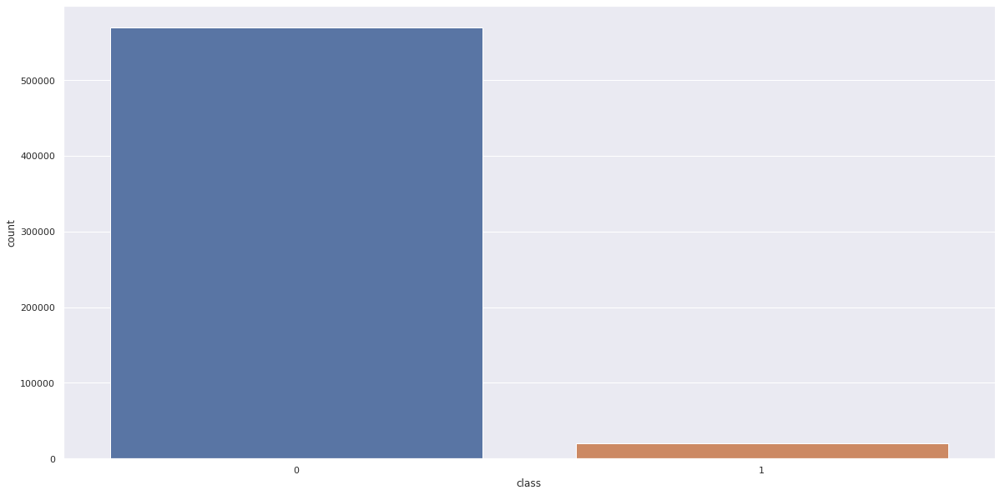

In [87]:
sns.set(rc={"figure.figsize":(20, 10)}) # set the figure size to make things look bigger.
sns.barplot(data=class_distrib, x="class", y="count")
# sns.countplot()

This dataset has a big imbalance issue. This will be an issue moving forward, we want to be careful about which metircs to use to evaluate our machine learning model 

In [94]:
pd.DataFrame(new_df.TransactionDT.value_counts().reset_index())

,index,TransactionDT
0,9474817.0,8
1,11576951.0,5
2,4397066.0,5
3,7236588.0,5
4,1544629.0,4
...,...,...
573344,4629634.0,1
573345,4629631.0,1
573346,4629557.0,1
573347,4629466.0,1


we do have a datetime column and we need to process it

In [89]:
from datetime import datetime, timedelta

In [231]:
# Date features

START_DATE         = '2017-12-01' 
# given that the start date is from this date forward. From above, the 8, 5, ..., 1 are 
startdate          = datetime.strptime(START_DATE, "%Y-%m-%d")
new_df["Date"]         = new_df['TransactionDT'].apply(lambda x: (startdate + timedelta(seconds=x)))
# adding time in seconds using the timedelta function inside another function we call lambda x: <expression>. 
# We then apply it to df.TransactionDT

# df.TransactionDT or df['TransactionDT']
# .apply() uses a function you define or stored in the library such as mean, min, max, to the column you specify

new_df['Weekdays']    = new_df['Date'].dt.dayofweek
new_df['Hours']       = new_df['Date'].dt.hour
new_df['Days']        = new_df['Date'].dt.day

In [101]:
df.Days.value_counts().sort_index().head(10)

1     18264
2     21894
3     24197
4     23223
5     20200
6     20095
7     18742
8     18117
9     18788
10    19074
Name: Days, dtype: int64

In [245]:
# Email Feature
new_df.P_emaildomain.value_counts().head(10)

Google           228851
Yahoo Mail       102909
NoInf             94456
Microsoft         59477
anonymous.com     36998
aol.com           28289
comcast.net        7888
icloud.com         6267
Others             4913
att.net            4033
Name: P_emaildomain, dtype: int64

In [109]:
def change_email_domain(df, col_name):
  df.loc[df[col_name].isin(['gmail.com', 'gmail']),col_name] = 'Gmail'

  df.loc[df[col_name].isin(['icloud.com']),col_name] = 'Icloud'

  df.loc[df[col_name].isin(['yahoo.com', 'yahoo.com.mx',  'yahoo.co.uk',
                                         'yahoo.co.jp', 'yahoo.de', 'yahoo.fr',
                                         'yahoo.es']), col_name] = 'Yahoo Mail'

  df.loc[df[col_name].isin(['hotmail.com','outlook.com','msn.com', 'live.com.mx', 
                                         'hotmail.es','hotmail.co.uk', 'hotmail.de',
                                         'outlook.es', 'live.com', 'live.fr',
                                         'hotmail.fr']), col_name] = 'Microsoft'

  df.loc[df[col_name].isin(df[col_name]\
                                         .value_counts()[df[col_name].value_counts() <= 500 ]\
                                         .index), col_name] = "Others"
                                         
  df[col_name].fillna("NoInf", inplace=True)
  print(df[col_name].value_counts().head(10))

In [110]:
change_email_domain(new_df, 'P_emaildomain')

Gmail            228851
Yahoo Mail       102909
NoInf             94456
Microsoft         59477
anonymous.com     36998
aol.com           28289
comcast.net        7888
Icloud             6267
Others             4913
att.net            4033
Name: P_emaildomain, dtype: int64


In [247]:
change_email_domain(new_df, 'R_emaildomain')

NoInf            453249
Gmail             57242
Microsoft         33604
anonymous.com     20529
Yahoo Mail        13691
aol.com            3701
Others             3586
comcast.net        1812
Icloud             1398
verizon.net         620
Name: R_emaildomain, dtype: int64


In [113]:
# Average fraud per transaction by Product CD

# groupby separates the data into different groups based on the value of that variable. (ex) variable called color. Within that, we have red, blue, green, yellow. THe groupby will make the data into 4 groups representing the 4 colors. 
new_df.groupby('ProductCD')['isFraud'].mean()

# 0 or 1. 

ProductCD
C    0.116873
H    0.047662
R    0.037826
S    0.058996
W    0.020399
Name: isFraud, dtype: float64

In [63]:
# Average fraud per transaction by email domain
df.groupby('P_emaildomain')['isFraud'].mean() # .max() or .median() or .min()

P_emaildomain
Google            0.043496
Microsoft         0.053298
NoInf             0.029538
Others            0.025646
Yahoo Mail        0.022544
anonymous.com     0.023217
aol.com           0.021811
att.net           0.007439
bellsouth.net     0.027763
charter.net       0.030637
comcast.net       0.031187
cox.net           0.020818
earthlink.net     0.021401
icloud.com        0.031434
mail.com          0.189624
me.com            0.017740
optonline.net     0.016815
rocketmail.com    0.003012
sbcglobal.net     0.004040
verizon.net       0.008133
ymail.com         0.020868
Name: isFraud, dtype: float64

In [217]:
def change_val_name(df, col_name):
  df[col_name] = df[col_name].fillna("NoInf") 
  df.loc[df[col_name].str.contains('ios', case=False), col_name] = 'IOS'
  df.loc[df[col_name].str.contains('android', case = False), col_name] = 'Android'
  df.loc[df[col_name].str.contains('mac', case = False), col_name] = 'Mac'
  df.loc[df[col_name].str.contains('windows', case = False), col_name] = 'Windows'
  df.loc[df[col_name].str.contains('linux', case = False), col_name] = 'Linux'
  df.loc[df[col_name].str.contains('chrome', case = False), col_name] = 'Chrome'
  df.loc[df[col_name].str.contains('safari', case = False), col_name] = 'Safari'
  df.loc[df[col_name].str.contains('firefox', case = False), col_name] = 'Firefox'
  df.loc[df[col_name].str.contains('edge', case = False), col_name] = 'Edge'
  df.loc[df[col_name].str.contains('ie', case = False), col_name] = 'IE'
  df.loc[df[col_name].str.contains('opera', case = False), col_name] = 'Opera'
  df.loc[df[col_name].str.contains('samsung', case = False), col_name] = 'SAMSUNG'

  less_than_500 = df[col_name].value_counts()[df[col_name].value_counts() <= 500].index
  df.loc[df[col_name].isin(less_than_500), col_name] = 'Others'
  #df.loc[~df[col_name].isin(['IOS', 'Android', 'Mac', 'Windows', 'Linux', 
                             #'Chrome', 'Safari', 'Firefox', 'Edge', 'IE', 'Opera', 'SAMSUNG']), col_name] = 'others'
  print(f'For {col_name}: \n {df[col_name].value_counts().head(10)}')
  print()  

In [219]:
change_val_name(new_df, 'id_30')
change_val_name(new_df, 'id_31')

For id_30: 
 NoInf      512975
Windows     36739
IOS         19782
Mac         13580
Android      6303
Linux        1136
Others         25
Name: id_30, dtype: int64

For id_31: 
 NoInf      450258
Chrome      54633
Safari      37281
Android     21383
IE           9733
Firefox      7017
Edge         6401
SAMSUNG      2247
Others       1020
IOS           567
Name: id_31, dtype: int64



## EDA (visualizations)

### Count plots (distribution)

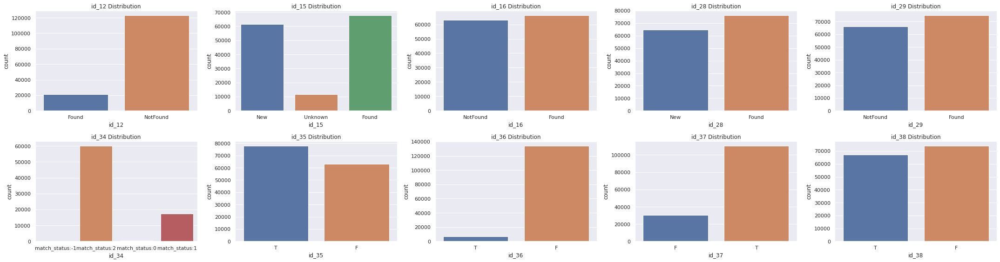

In [168]:
# Create barplot for id categorical variables
fig, axs = plt.subplots(2, 5, figsize=(30, 8))

for index, col in enumerate(['id_12', 'id_15', 'id_16', 'id_28', 'id_29', 
                             'id_34', 'id_35', 'id_36', 'id_37', 'id_38']):
    row = index // 5
    column = index % 5
    tmp = pd.crosstab(new_df[col], new_df['isFraud'], normalize='index') * 100
    tmp = tmp.reset_index()
    tmp.rename(columns={0:'NoFraud', 1:'Fraud'}, inplace=True)
    tmp = tmp.sort_values(by='Fraud', ascending=True)
    g = sns.countplot(x=col,  data=new_df, order=list(tmp[tmp[col]!='NaN'][col].values), ax=axs[row][column])
    g.set_title(f"{col} Distribution")

plt.tight_layout()
plt.show()

Do the same for the C, D, M, V-variables, ids, etc

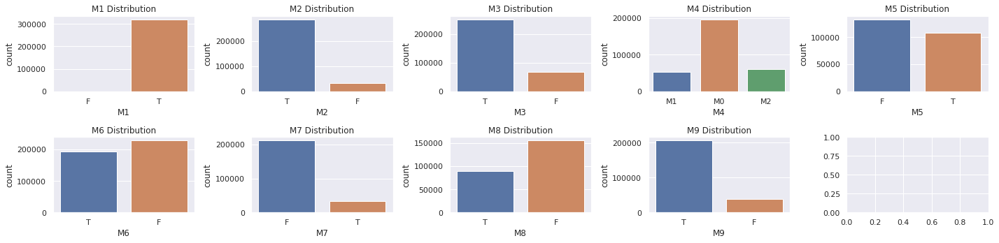

In [162]:
# Create barplot for M categorical variables
fig, axs = plt.subplots(2, 5, figsize=(20, 5))

for index, col in enumerate(['M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9']):
    row = index // 5
    column = index % 5
    tmp = pd.crosstab(new_df[col], new_df['isFraud'], normalize='index') * 100
    tmp = tmp.reset_index()
    tmp.rename(columns={0:'NoFraud', 1:'Fraud'}, inplace=True)
    tmp = tmp.sort_values(by='Fraud', ascending=True)

    g = sns.countplot(x=col, data=new_df, order=list(tmp[tmp[col]!='NaN'][col].values), ax=axs[row][column])
    g.set_title(f"{col} Distribution")

plt.tight_layout()
plt.show()

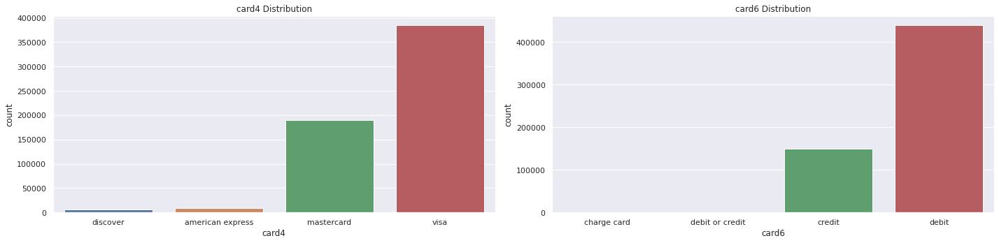

In [177]:
# Create barplot for card categorical variables
fig, axs = plt.subplots(1, 2, figsize=(20, 5))
for index, col in enumerate(['card4', 'card6']):
    g = sns.countplot(x=col, data=new_df, order=new_df[col].value_counts().sort_values().index, ax=axs[index])
    g.set_title(f"{col} Distribution")

plt.tight_layout()
plt.show()

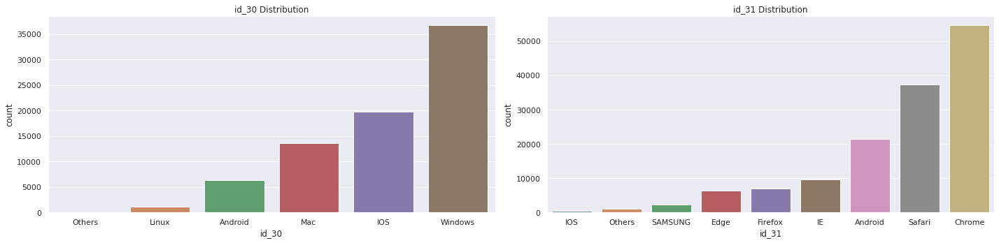

In [224]:
# Create barplot for id_30 and id_31 categorical variables
fig, axs = plt.subplots(1, 2, figsize=(20, 5))
for index, col in enumerate(['id_30', 'id_31']):
    g = sns.countplot(x=col, data=new_df.query(f"{col}!='NoInf'"), order=new_df[col].value_counts().head(10).drop('NoInf').sort_values().index, ax=axs[index])
    g.set_title(f"{col} Distribution")

plt.tight_layout()
plt.show()

<AxesSubplot:xlabel='DeviceType', ylabel='count'>

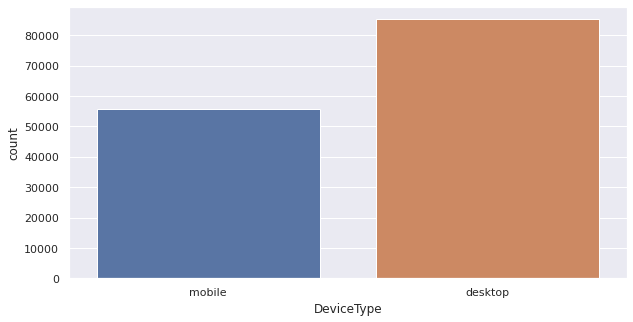

In [227]:
plt.figure(figsize=(10, 5))
sns.countplot(x='DeviceType', data=new_df, order = new_df['DeviceType'].value_counts().sort_values().index)

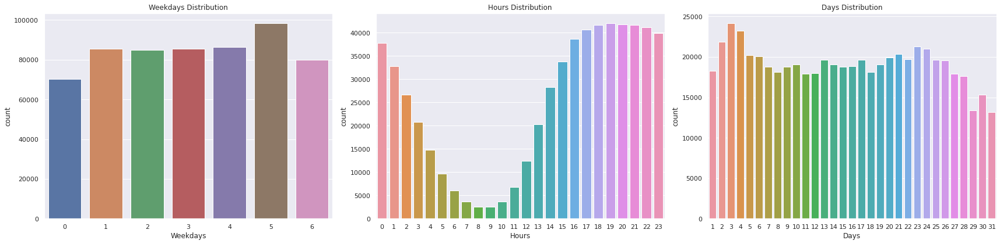

In [240]:
# Create barplot for Date categorical variables
fig, axs = plt.subplots(1, 3, figsize=(24, 6))

for index, col in enumerate(['Weekdays','Hours','Days']):
    tmp = pd.crosstab(new_df[col], new_df['isFraud'], normalize='index') * 100
    tmp = tmp.reset_index()
    tmp.rename(columns={0:'NoFraud', 1:'Fraud'}, inplace=True)
    tmp = tmp.sort_values(by='Fraud', ascending=True)

    g = sns.countplot(x=col, data=new_df, order=list(tmp[col].sort_index()), ax=axs[index])
    g.set_title(f"{col} Distribution")

plt.tight_layout()
plt.show()

### Distribution

Text(0, 0.5, 'Probability')

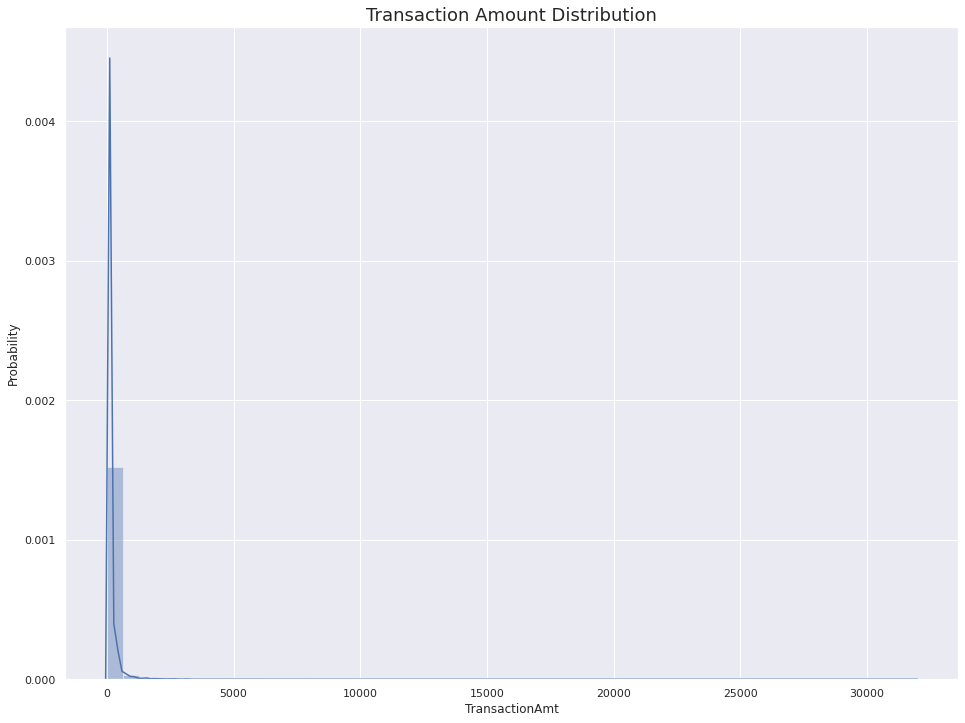

In [ ]:
# Distribution plot of Transaction Amount
plt.figure(figsize=(16,12))

sns.distplot(df['TransactionAmt'])
plt.title("Transaction Amount Distribution", fontsize=18)
plt.ylabel("Probability")

Heavily skewed to the right: not anything close to a normal distribution at all

Let's narrow down further:
See the distribute of the lower values (restrict to a narrower range)

Text(0, 0.5, 'Probability')

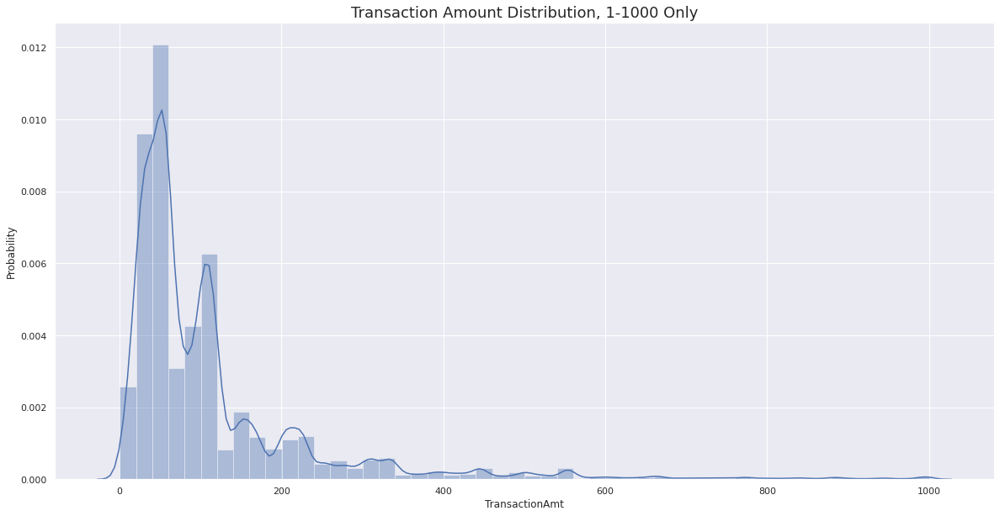

In [ ]:
# sns.distplot(df['TransactionAmt'])
sns.set(rc={"figure.figsize":(20, 10)}) # set the figure size to make things look bigger.
sns.distplot(df[df['TransactionAmt'] <= 1000]['TransactionAmt']) # (([[]]))
plt.title("Transaction Amount Distribution, 1-1000 Only", fontsize=18)
plt.ylabel("Probability")

We can find the log of the TransactionAmt column to make it distribution appear more centered and more like normal distribution. Could also try np.sqrt()

Some models are very sensitive to distribution of data. 

Text(0, 0.5, 'Probability')

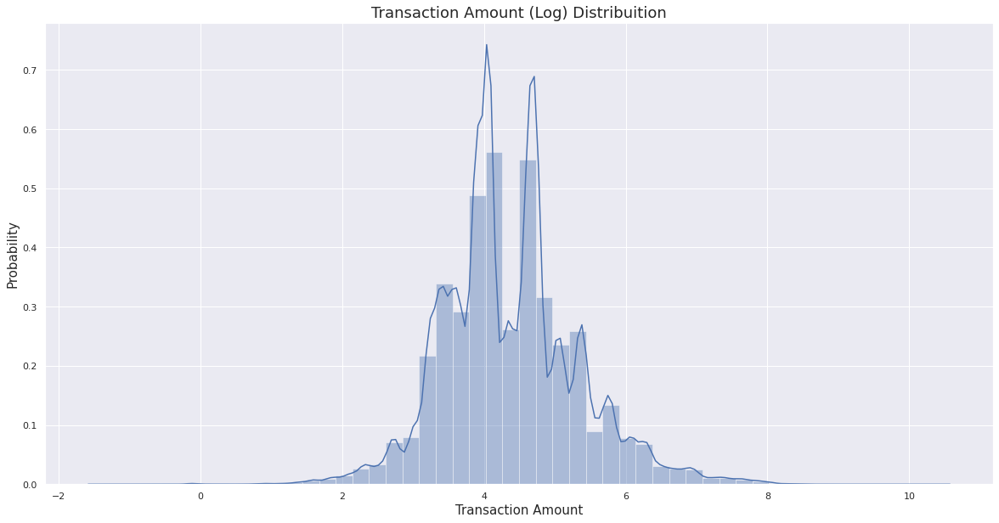

In [ ]:
sns.distplot(np.log(df['TransactionAmt']))
plt.title("Transaction Amount (Log) Distribuition", fontsize=18)
plt.xlabel("Transaction Amount", fontsize=15)
plt.ylabel("Probability", fontsize=15)

# Reminder:
1. create a new col to np.log()

In [ ]:
pd.crosstab(df[col], df['isFraud'], normalize='index')

id29_table = df.groupby(["id_29"])["isFraud"].value_counts()
id29 = pd.DataFrame(id29_table)
id29

isFraud
id_29    isFraud         
Found    0          67099
         1           7827
NaN      0         440117
         1           9445
NotFound 0          62661
         1           3391

In [ ]:
def plot_cat_feat_dist(df, col):
    tmp = pd.crosstab(df[col], df['isFraud'], normalize='index') * 100
    tmp = tmp.reset_index()
    tmp.rename(columns={0:'NoFraud', 1:'Fraud'}, inplace=True)

    plt.figure(figsize=(25, 18))
    plt.suptitle(f'{col} Distributions', fontsize=22)

    plt.subplot(221)
    g = sns.countplot(x=col, data=df, order=tmp[col].values)

    g.set_title(f"{col} Distribution", fontsize=16)
    g.set_xlabel(f"{col} Name", fontsize=17)
    g.set_ylabel("Count", fontsize=17)
        
    plt.subplot(222)
    g1 = sns.countplot(x=col, hue='isFraud', data=df, order=tmp[col].values)
    plt.legend(title='Fraud', loc='best', labels=['No', 'Yes'])

    g1.set_title(f"{col} Distribution by Target Variable (isFraud) ", fontsize=16)
    g1.set_xlabel(f"{col} Name", fontsize=17)
    g1.set_ylabel("Count", fontsize=17)

    plt.subplots_adjust(hspace = 0.4, top = 0.85)

    plt.show()

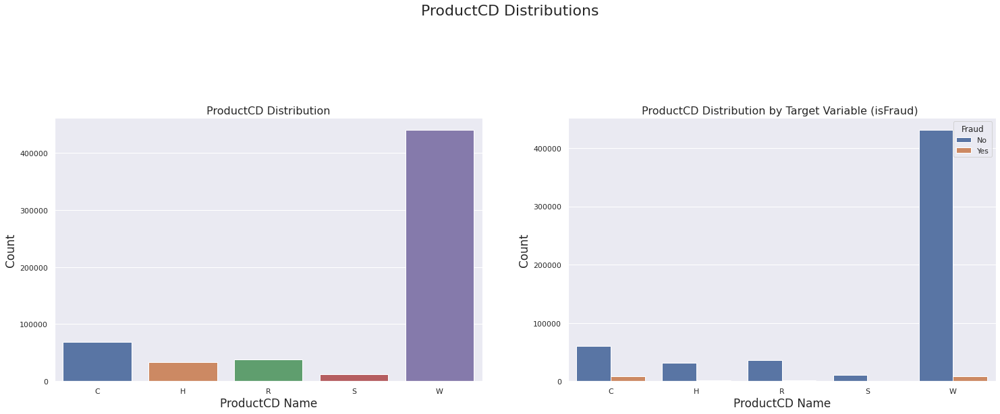

In [ ]:
plot_cat_feat_dist(df, "ProductCD")

In [ ]:
# Average fraud per transaction by ProductCD
df.groupby('ProductCD')['isFraud'].mean()

ProductCD
C    0.116873
H    0.047662
R    0.037826
S    0.058996
W    0.020399
Name: isFraud, dtype: float64

Some findings so far:

1. Fraud rate is highest for Product C and lowest (on average) for Product W

2. More transctions happen on Saturday than weekdays (which are more or less similar) except a low on Monday

3. As for ProductCD, A significantly high number of W's than everything else

### Card Features

In [ ]:
df.groupby(["card4"])["isFraud"].mean()

card4
american express    0.028698
discover            0.077282
mastercard          0.034331
visa                0.034756
Name: isFraud, dtype: float64



df['col2'] = stats.zscore(df['col2'])

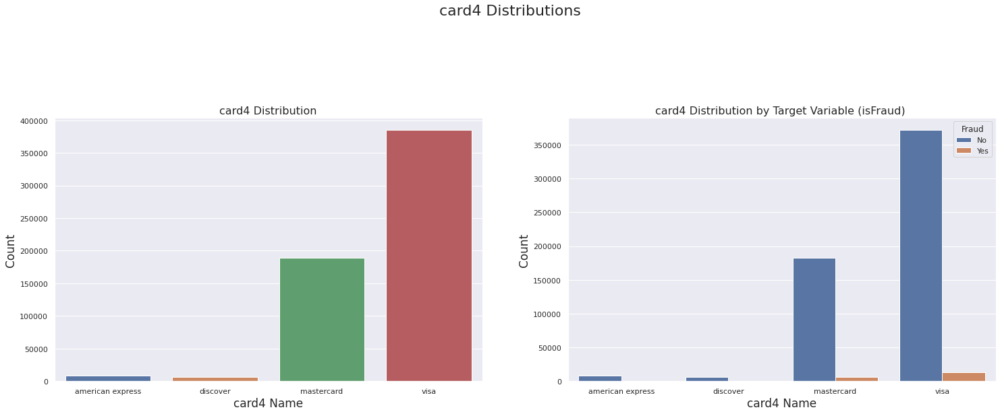

In [ ]:
plot_cat_feat_dist(df, "card4")

More cases for the Visa and Mastercard, but this could also be a matter of them having more card counts

In [ ]:
df.groupby(["card4"])["isFraud"].mean()

card4
american express    0.028698
discover            0.077282
mastercard          0.034331
visa                0.034756
Name: isFraud, dtype: float64

Higher chance if you have the "discover" card for fruadulous cases. Mastercard and Visa do take more share of fraudulant cases but their percentages are both lower than "discover" cards.

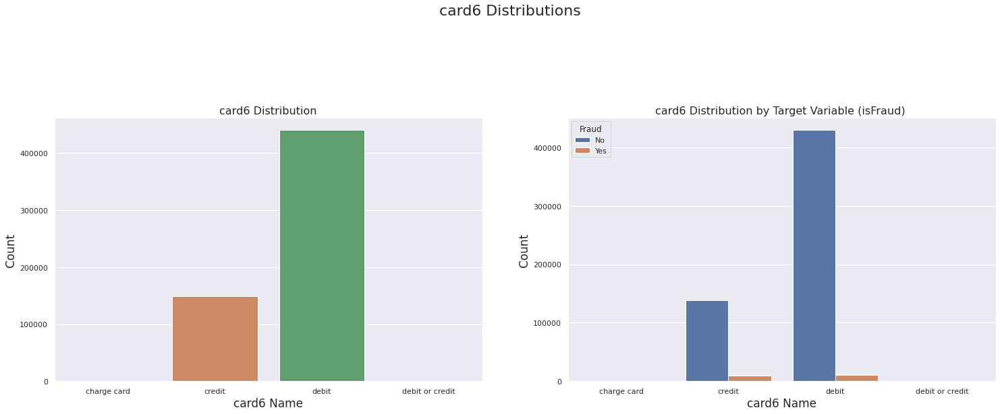

In [ ]:
plot_cat_feat_dist(df, "card6")

#### Introducing Plotly 

(my personal favorite: very intuitive interface, easy to pick up; plot without big learning curve)

In [241]:
#!pip install --upgrade plotly

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.2/15.2 MB 58.6 MB/s eta 0:00:00
  Attempting uninstall: plotly
    Found existing installation: plotly 5.5.0
    Uninstalling plotly-5.5.0:
      Successfully uninstalled plotly-5.5.0


In [ ]:
#!pip install --upgrade jupyter-dash

In [243]:
import plotly.express as px

In [253]:
fig = px.histogram(new_df[new_df['P_emaildomain'] != 'NoInf'], x='P_emaildomain', text_auto='.2s',
            title="P_emaildomain")
fig.update_layout(xaxis_categoryorder='total descending')
fig.show()

In [259]:
new_df.groupby('P_emaildomain')['isFraud'].mean().sort_values(ascending=False)

P_emaildomain
mail.com          0.189624
Microsoft         0.053298
Google            0.043496
icloud.com        0.031434
comcast.net       0.031187
charter.net       0.030637
NoInf             0.029538
bellsouth.net     0.027763
Others            0.025646
anonymous.com     0.023217
Yahoo Mail        0.022544
aol.com           0.021811
earthlink.net     0.021401
ymail.com         0.020868
cox.net           0.020818
me.com            0.017740
optonline.net     0.016815
verizon.net       0.008133
att.net           0.007439
sbcglobal.net     0.004040
rocketmail.com    0.003012
Name: isFraud, dtype: float64

In [254]:
fig = px.histogram(new_df[new_df['R_emaildomain'] != 'NoInf'], x='R_emaildomain', text_auto='.2s',
            title="R_emaildomain")
fig.update_layout(xaxis_categoryorder='total descending')
fig.show()

In [260]:
new_df.groupby('R_emaildomain')['isFraud'].mean().sort_values(ascending=False)

R_emaildomain
Icloud           0.128755
Gmail            0.118986
Microsoft        0.080764
Yahoo Mail       0.046235
Others           0.035973
aol.com          0.034855
anonymous.com    0.029130
NoInf            0.020819
me.com           0.019784
comcast.net      0.011589
sbcglobal.net    0.001812
verizon.net      0.000000
Name: isFraud, dtype: float64

Google and Microsoft and icloud have the largest amount of fraudulous percentage 

P-email Domain

In [262]:
new_df.groupby(["P_emaildomain"])['TransactionAmt'].sum().sort_values(ascending=False)

P_emaildomain
Google            inf
cox.net           inf
verizon.net       inf
sbcglobal.net     inf
rocketmail.com    inf
optonline.net     inf
me.com            inf
mail.com          inf
icloud.com        inf
earthlink.net     inf
comcast.net       inf
Microsoft         inf
charter.net       inf
bellsouth.net     inf
att.net           inf
aol.com           inf
anonymous.com     inf
Yahoo Mail        inf
Others            inf
NoInf             inf
ymail.com         inf
Name: TransactionAmt, dtype: float16

In [ ]:
# write down your own visualization code to see different aspects of the data

1. numeric: scatterplot, regression (lm) if you do the ggplot, boxplot, violinplot, heatmaps (correlation)
2. categorical: (sns) distplot (countplot), barplot (useful to take average first or sth)

SNS and / or PLOTLY

In [270]:
import plotly.graph_objects as go

In [268]:
numeric_col_partial = ['TransactionAmt','card1','card2','card3','card5','addr1','addr2','dist1']

In [273]:
# create boxplot for amount of transaction 
fig = go.Figure()
fig.add_trace(go.Box(y=new_df['TransactionAmt'], name='TransactionAmt'))
fig.update_layout(title='Boxplot for TransactionAmt', yaxis_title='Value')
fig.update_yaxes(range=[0, 300])
fig.show()

In [274]:
# create boxplot for card numerical variable
fig = go.Figure()
for col in ['card1','card2','card3','card5']:
    fig.add_trace(go.Box(y=new_df[col], name=col))

fig.update_layout(title='Boxplot for Numerical Variables', yaxis_title='Value')
fig.show()

In [275]:
# create boxplot for address numerical variable
fig = go.Figure()
for col in ['addr1','addr2']:
    fig.add_trace(go.Box(y=new_df[col], name=col))

fig.update_layout(title='Boxplot for Numerical Variables', yaxis_title='Value')
fig.show()

In [282]:
# create boxplot for dist numerical variables
fig = go.Figure()
fig.add_trace(go.Box(y=new_df['dist1'], name='dist1'))
fig.update_layout(title='Boxplot for dist1', yaxis_title='Value')
fig.update_yaxes(range=[0, 80])
fig.show()

In [ ]:
"""
from scipy import stats
  
  
# Creating the data frame
details = {
    'col1': [1, 3, 5, 7, 9],
    'col2': [7, 4, 35, 14, 56]
}
  
# creating a Dataframe object
df = pd.DataFrame(details)

# Z-Score using scipy
df['col2'] = stats.zscore(df['col2'])
"""

In [ ]:
# transaction amt / group by card 1, [transaction amt] .transform(mean)
# transaction amt / group by card 4, [transaction amt] .transform(mean)
# transaction amt / group by card 1, [transaction amt] .transform(std)
# transaction amt / group by card 4, [transaction amt] .transform(std)


In [ ]:
plot()

In [ ]:
df.Hours.mean()

13.861922985741863

Fill N/As (in the data columns it would just be empty values or blank) for id columns:

1. Find the ID columns
2. fillna with mean or median. You decide. Why?
3. Some other ways to fill the na for numeric data?



# ID

In [ ]:
for col in ['id_12', 'id_15', 'id_16', 'id_28', 'id_29']:
    df[col] = df[col].fillna('NaN')

df.loc[df['id_30'].str.contains('Windows', na=False), 'id_30'] = 'Windows'
df.loc[df['id_30'].str.contains('iOS', na=False), 'id_30'] = 'iOS'
df.loc[df['id_30'].str.contains('Mac OS', na=False), 'id_30'] = 'Mac'
df.loc[df['id_30'].str.contains('Android', na=False), 'id_30'] = 'Android'
df['id_30'].fillna("NAN", inplace=True)

In [ ]:
df.loc[df['id_31'].str.contains('chrome', na=False), 'id_31'] = 'Chrome'
df.loc[df['id_31'].str.contains('firefox', na=False), 'id_31'] = 'Firefox'
df.loc[df['id_31'].str.contains('safari', na=False), 'id_31'] = 'Safari'
df.loc[df['id_31'].str.contains('edge', na=False), 'id_31'] = 'Edge'
df.loc[df['id_31'].str.contains('ie', na=False), 'id_31'] = 'IE'
df.loc[df['id_31'].str.contains('samsung', na=False), 'id_31'] = 'Samsung'
df.loc[df['id_31'].str.contains('opera', na=False), 'id_31'] = 'Opera'

https://pandas.pydata.org/docs/reference/api/pandas.Series.str.contains.html

In [ ]:
df['id_31'].str

df.loc[ [T F T T F ...], column_name ] = some_value

In [ ]:
df['id_31'].str.contains('ie', na=False)

0         False
1         False
2         False
3         False
4         False
          ...  
590535    False
590536    False
590537    False
590538    False
590539    False
Name: id_31, Length: 590540, dtype: bool

In [ ]:
df.id_31.value_counts() < 200

chrome 63.0                       False
mobile safari 11.0                False
mobile safari generic             False
ie 11.0 for desktop               False
safari generic                    False
chrome 62.0                       False
chrome 65.0                       False
chrome 64.0                       False
chrome 63.0 for android           False
chrome generic                    False
chrome 66.0                       False
edge 16.0                         False
chrome 64.0 for android           False
chrome 65.0 for android           False
firefox 57.0                      False
mobile safari 10.0                False
chrome 66.0 for android           False
chrome 62.0 for android           False
edge 15.0                         False
chrome generic for android        False
firefox 59.0                      False
samsung browser 6.2               False
firefox 58.0                      False
chrome 49.0                       False
firefox                           False


In [ ]:
df.id_31.value_counts()[df.id_31.value_counts() < 200]

chrome 58.0                       188
firefox 48.0                      179
chrome 66.0 for ios               159
chrome 52.0 for android           152
Samsung/SM-G532M                  150
chrome 50.0 for android           145
opera 49.0                        138
chrome 59.0                       133
firefox 56.0                      126
safari 10.0                       111
firefox generic                   110
samsung browser 7.0               101
android browser 4.0               100
chrome 56.0                        98
mobile safari uiwebview            97
chrome 57.0                        94
chrome 57.0 for android            87
opera                              83
chrome 54.0 for android            82
Generic/Android 7.0                81
chrome 65.0 for ios                79
opera generic                      78
edge 17.0                          74
chrome 43.0 for android            72
chrome 46.0 for android            69
chrome 55.0                        64
edge 13.0   

In [ ]:
df.id_31.value_counts()[df.id_31.value_counts() < 200].index

Index(['chrome 58.0', 'firefox 48.0', 'chrome 66.0 for ios',
       'chrome 52.0 for android', 'Samsung/SM-G532M',
       'chrome 50.0 for android', 'opera 49.0', 'chrome 59.0', 'firefox 56.0',
       'safari 10.0', 'firefox generic', 'samsung browser 7.0',
       'android browser 4.0', 'chrome 56.0', 'mobile safari uiwebview',
       'chrome 57.0', 'chrome 57.0 for android', 'opera',
       'chrome 54.0 for android', 'Generic/Android 7.0', 'chrome 65.0 for ios',
       'opera generic', 'edge 17.0', 'chrome 43.0 for android',
       'chrome 46.0 for android', 'chrome 55.0', 'edge 13.0',
       'chrome 62.0 for ios', 'edge', 'Generic/Android', 'ie', 'chrome 51.0',
       'google search application 49.0', 'google search application 48.0',
       'opera 52.0', 'mobile safari 8.0', 'chrome 49.0 for android',
       'Samsung/SM-G531H', 'opera 51.0', 'opera 53.0', 'chrome 64.0 for ios',
       'chrome 51.0 for android', 'samsung browser 5.4', 'safari 9.0',
       'chrome 53.0 for android', '

In [ ]:
df.id_31.isin(df.id_31.value_counts()[df.id_31.value_counts() < 200].index)

0         False
1         False
2         False
3         False
4         False
          ...  
590535    False
590536    False
590537    False
590538    False
590539    False
Name: id_31, Length: 590540, dtype: bool

In [ ]:
df.loc[df.id_31.isin(df.id_31.value_counts()[df.id_31.value_counts() < 200].index), 'id_31'] = "Others"

df['id_31'].fillna("NAN", inplace=True)

In [ ]:
from scipy import stats
  
  
# Creating the data frame
details = {
    'col1': [1, 3, 5, 7, 9],
    'col2': [7, 4, 35, 14, 56]
}
  
# creating a Dataframe object
demo = pd.DataFrame(details)
  
# Z-Score using scipy
demo['col2'] = stats.zscore(demo['col2'])

In [ ]:
demo

,col1,col2
0,1,-0.824387
1,3,-0.977052
2,5,0.600480
3,7,-0.468171
4,9,1.669130


### Significance Tests

Chi-Squared Test

Chi-Square test tells if the entire variable is useful or not.

First let's separate columns by their types:
1. cat_columns
2. binary_columns
3. num_columns

In [ ]:
cat_columns = df.select_dtypes(include=['object']).columns
len(cat_columns)

binary_columns = [col for col in df.columns if df[col].nunique() == 2]
len(binary_columns)

num_columns = [col for col in df.columns if (col not in cat_columns) & (col not in binary_columns)]
len(num_columns)

399

In [ ]:
print(f"Number of columns \n\ncategorical: {len(cat_columns)}\nbinary: {len(binary_columns)} \nnumerical: {len(num_columns)}")

Number of columns 

categorical: 31
binary: 22 
numerical: 399


Import Library

In [ ]:
from scipy.stats import chi2_contingency

In [ ]:
# See the odds (the ratio of the 1 class to the 0 class) 
ctab = pd.crosstab(df['ProductCD'], df['isFraud'].astype('category')) # nothing but a few 
ctab

isFraud,0,1
ProductCD,,
C,60511,8008
H,31450,1574
R,36273,1426
S,10942,686
W,430701,8969


In [ ]:
cat_columns = cat_columns.to_list() + binary_columns

Chi_squared tests have to do with categorical columns (variables) to see if the observed values for the groups within that column are any different from the expected.

In [ ]:
# significance value
alpha = 0.05

significant_categorical_variables = []

for col in cat_columns:  
    # Create a crosstab table
    temp = pd.crosstab(df[col], df['isFraud'].astype('category'))
    
    # Get chi-square value , p-value, degrees of freedom, expected frequencies using the function chi2_contingency
    stat, p, dof, expected = chi2_contingency(temp)
    
    # Determine whether to reject or keep your null hypothesis
    print(col.ljust(40), ',  chisquared=%.5f,   p-value=%.5f' % (stat, p))
    if p <= alpha:
        significant_categorical_variables.append(col)
    else:
        continue

ProductCD                                ,  chisquared=16742.17153,   p-value=0.00000
card4                                    ,  chisquared=364.87414,   p-value=0.00000
card6                                    ,  chisquared=5957.03229,   p-value=0.00000
P_emaildomain                            ,  chisquared=2652.43233,   p-value=0.00000
R_emaildomain                            ,  chisquared=17297.50859,   p-value=0.00000
M1                                       ,  chisquared=0.00000,   p-value=1.00000
M2                                       ,  chisquared=438.61321,   p-value=0.00000
M3                                       ,  chisquared=477.66057,   p-value=0.00000
M4                                       ,  chisquared=6450.44798,   p-value=0.00000
M5                                       ,  chisquared=242.42169,   p-value=0.00000
M6                                       ,  chisquared=227.96414,   p-value=0.00000
M7                                       ,  chisquared=11.25610,   p-va

In [ ]:
ctab.columns = ctab.columns.add_categories('odds')
ctab['odds'] = ctab[1]/ctab[0]
ctab

isFraud,0,1,odds
ProductCD,,,
C,60511,8008,0.132340
H,31450,1574,0.050048
R,36273,1426,0.039313
S,10942,686,0.062694
W,430701,8969,0.020824


Odds ratio simply means dividing the odds by 

In [ ]:
ctab.columns = ctab.columns.add_categories('odds_ratio')
ctab['odds_ratio'] = ctab['odds'] / (ctab[1].sum()/ctab[0].sum())
ctab

isFraud,0,1,odds,odds_ratio
ProductCD,,,,
C,60511,8008,0.132340,3.649871
H,31450,1574,0.050048,1.380295
R,36273,1426,0.039313,1.084236
S,10942,686,0.062694,1.729080
W,430701,8969,0.020824,0.574323


Highers odds ratio implies more chance of fraud in that category.

Farther away it is from 1.0 (both directions) more important the variable is.

### ANOVA test 

ANOVA test is a test of variance. However, the test statistic is actually the sample mean. 

First we need to understand what is it we are dealing with (we can't do any testing or technique without knowing WHAT we are working with in the first place. Sometimes, Statistics contains many terms that you kind of understand. 

But no, this is not the best approach. We need to know exactly what we are working with:
1. mean is a number (take the average of a bunch of numbers)
2. variance is similar to a range (measures spread; how spread out is the data) 

This is counterintuitive yet it is true in this case. We are determining if the variance between different groups (within the column / variable of interest) is statisically significant by comparing the sample means, not variance itself. 

Assumptions:

1. Samples are independent.

2. Each sample is from a normally distributed population.

3. The population standard deviations of the groups are all equal. This property is called homoscedasticity.


ANOVA deals with numerical variables / columns whereas CHi-squared tests deal with categorical

In [ ]:
num_columns

### Your turn to code the ANOVA test:

1. follow the general directions listed below

2. refer back to the chi-squared test implementation

3. when in doubt, break code down and google things you don't know

In [ ]:
# import library f_oneway from scipy.stats
from scipy.stats import f_oneway
# set significance value
sig_val = 0.05
# set a list variable (for storing items later)
significant_numerical_variables = []
# for loop (hint: only numerical columns) 
for col in num_columns:
    # if number of unique values for this column exceeds 50 (or some other number you choose)
    if df[col].nunique() > 50: 
      # use f_oneway function. Don't forget to dropna for the 2 inputs (the df with isfraud==1 and isfraud==0). What 2 outputs does f_oneway return? 
      # Name those 2 outputs using some reasonable names
      F, p = f_oneway(df[df.isFraud == 1][col].dropna(), 
                      df[df.isFraud == 0][col].dropna())
      # print them out. Also be sure to print out the column name. 
      print(col.ljust(40), ',   F-statistic=%.5f, p=%.5f' % (F, p), df.loc[:, col].nunique())
      # if <some_condition> (hint: has to do with p-value vs significance value):
      if p <= sig_val:
        significant_numerical_variables.append(col)
          # append the column into the list variable above


TransactionID                            ,   F-statistic=118.52652, p=0.00000 590540
TransactionDT                            ,   F-statistic=101.40691, p=0.00000 573349
TransactionAmt                           ,   F-statistic=75.67718, p=0.00000 8195
card1                                    ,   F-statistic=109.88932, p=0.00000 13553
card2                                    ,   F-statistic=6.67558, p=0.00977 500
card3                                    ,   F-statistic=14336.21578, p=0.00000 114
card5                                    ,   F-statistic=661.82659, p=0.00000 119
addr1                                    ,   F-statistic=16.43435, p=0.00005 332
addr2                                    ,   F-statistic=485.06660, p=0.00000 74
dist1                                    ,   F-statistic=110.42966, p=0.00000 2412
dist2                                    ,   F-statistic=13.66508, p=0.00022 1699
C1                                       ,   F-statistic=552.37693, p=0.00000 1495
C2      

Interpret the results

In [ ]:
df.card5.nunique()

fill na

scaling 

In [ ]:
# fill na

In [ ]:
# try some standard scaling for numerical variables 

Drop columns:

There is 1 obvious column that can be dropped because it does not add any useful information. What is it? 

Once you identify it, drop it. 

Also drop the date column

In [ ]:
# df.drop([...], axis=1) or df.drop(..., inplace=True)

In [ ]:
# delete the date column because we made some new time variables

In [ ]:
from pandas_summary import DataFrameSummary

df_summary = DataFrameSummary(df)
df_summary.summary()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,Date,Weekdays,Hours,Days,Trans_min_mean,Trans_min_std
count,590540.0,590540.0,590540.0,590540.0,NaN,590540.0,581607.0,588975.0,NaN,586281.0,NaN,524834.0,524834.0,238269.0,37627.0,NaN,NaN,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,589271.0,309743.0,327662.0,421618.0,280699.0,73187.0,38917.0,74926.0,74926.0,514518.0,311253.0,64717.0,61952.0,62187.0,501427.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,81945.0,81945.0,81945.0,81945.0,81945.0,81951.0,81951.0,81951.0,81945.0,81945.0,81945.0,81945.0,81951.0,81951.0,81951.0,81945.0,81945.0,81945.0,81945.0,81945.0,81945.0,81951.0,81

In [ ]:
#!unzip /content/intermediate.pkl.zip

import pickle

with open('/content/intermediate.pkl', 'rb') as f:
    df = pickle.load(f)

In [ ]:
df.drop(columns=["TransactionID", "Date"], inplace=True)

# Feature Engineering

https://towardsdatascience.com/all-about-categorical-variable-encoding-305f3361fd02#:~:text=implement%20as%20below%3A-,Weight%20of%20Evidence%20Encoding,the%20credit%20and%20financial%20industry.


https://contrib.scikit-learn.org/category_encoders/targetencoder.html


In [ ]:
cat_columns = df.select_dtypes(include=['object']).columns
print(len(cat_columns))
binary_columns = [col for col in df.columns if df[col].nunique() == 2]
print(len(binary_columns))
num_columns = [col for col in df.columns if (col not in cat_columns) & (col not in binary_columns)]
print(len(num_columns))

29
435
393


use np.log to transform the transactionAmt.

Why? 

Because transactionAmt has few very large values and many lower values causing a big discrepency. 

In [ ]:
df['TransactionAmt'] = np.log(df['TransactionAmt'])

let's make a special feature

Transaction amount - mean of transaction (use np.nanmean to avoid the N/A values)

In [ ]:
df['Trans_min_mean'] = df['TransactionAmt'] - np.nanmean(df['TransactionAmt'], dtype="float64")

Create another one (use np.nanstd())

This is to create a z-score 

Why Standardize your Data?

https://builtin.com/data-science/when-and-why-standardize-your-data


In [ ]:
df['Trans_min_std']  = df['Trans_min_mean'] / np.nanstd(df['TransactionAmt'].astype("float64"), dtype="float64")

In [ ]:
df['TransactionAmt_to_mean_card1'] = df['TransactionAmt'] / df.groupby(['card1'])['TransactionAmt'].transform('mean')
df['TransactionAmt_to_mean_card4'] = df['TransactionAmt'] / df.groupby(['card4'])['TransactionAmt'].transform('mean')
df['TransactionAmt_to_std_card1']  = df['TransactionAmt'] / df.groupby(['card1'])['TransactionAmt'].transform('std')
df['TransactionAmt_to_std_card4']  = df['TransactionAmt'] / df.groupby(['card4'])['TransactionAmt'].transform('std')

https://betterdatascience.com/top-csv-alternatives/

In [ ]:
!unzip /content/intermediate.pkl.zip

import pickle

with open('/content/need_encoding.pkl', 'rb') as f:
    df = pickle.load(f)

Fill na values and scale V columns


Below is to correct the data error

In [ ]:
!unzip /content/intermediate.pkl.zip
import pickle

with open('/content/intermediate.pkl', 'rb') as f:
    df = pickle.load(f)

Archive:  /content/intermediate.pkl.zip
  inflating: intermediate.pkl        
  inflating: __MACOSX/._intermediate.pkl  


## Partial-Fill NA and PCA 

There are 2 ways to do scaling + PCA:

1. Transform the Dataset and then work with a model
2. Build a pipeline so that the scaling + PCA becomes part of the model itself. We will see how to do that with the Scikit-learn package

In [ ]:
df.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_13,id_14,id_17,id_19,id_20,id_32,_Weekdays,_Hours,_Days,Trans_min_mean,Trans_min_std,TransactionAmt_to_mean_card1,TransactionAmt_to_mean_card4,TransactionAmt_to_std_card1,TransactionAmt_to_std_card4
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.0,588975.0,586281.0,524834.0,524834.0,238269.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,589271.0,309743.0,327662.0,421618.0,280699.0,73187.0,74926.000000,74926.000000,514518.0,311253.0,64717.0,61952.0,62187.0,501427.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,311253.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,514467.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,421571.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,513444.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,501376.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.0,590226.000000,590226.000000,590226.000000,590226.0,590226.0,590226.0,590226.000000,590226.00000,590226.000000,590226.000000,590226.000000,590226.000000,81945.0,81945.0,81945.0,81945.0,81945.0,81951.0,81951.0,81951.0,81945.0,81945.0,81945.0,81945.0,81951.0,81951.0,81951.0,81945.0,81945.0,81945.0,81945.0,81945.0,81945.0,81951.0,81951.000000,81945.0,81945.0,81945.0,81951.000000,81951.000000,81951.000000,139631.0,139631.0,139819.0,139819.0,139819.0,139631.0,1

In [ ]:
df.columns.get_loc("V1"), df.columns.get_loc("V339")

(53, 391)

In [ ]:
filter_col = df.columns[53:392]

In [ ]:
for col in filter_col:
    df[col].fillna((df[col].median()), inplace=True) #
    df[col] = (minmax_scale(df[col], feature_range=(0, 1)))

In [ ]:
# initialize function to perform PCA
def perform_PCA(df, cols, n_components, prefix='PCA_', rand_seed=4):
    pca = PCA(n_components=n_components, random_state=rand_seed)
    principalComponents = pca.fit_transform(df[cols])
    principalDf = pd.DataFrame(principalComponents)
    df.drop(cols, axis=1, inplace=True)

    principalDf.rename(columns=lambda x: str(prefix)+str(x), inplace=True)
    df = pd.concat([df, principalDf], axis=1)
    return df

In [ ]:
df = perform_PCA(df, filter_col, prefix='PCA_V_', n_components=30)

In [ ]:
df = reduce_mem_usage(df)

Mem. usage decreased to 1154.72 Mb (4.5% reduction)


In [ ]:
# Perform PCA for filter columns (for next time)

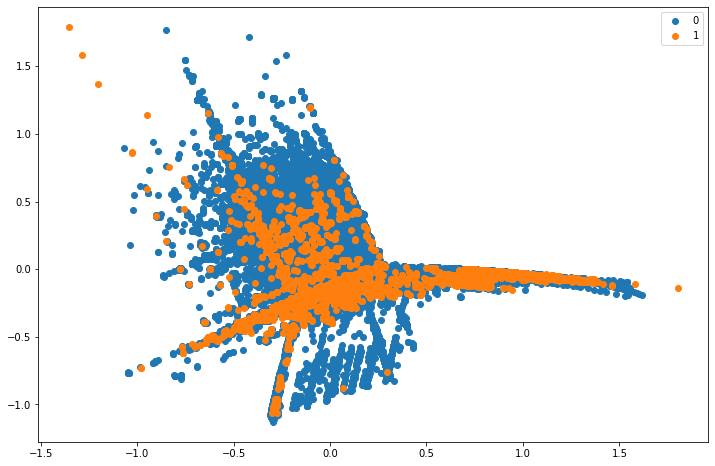

In [ ]:
# Plot first 2 PCA features and colour by target variable
plt.figure(figsize=(12, 8));
groups = df.groupby("isFraud")
for name, group in groups:
    plt.scatter(group["PCA_V_0"], group["PCA_V_1"], label=name)
plt.legend()
plt.show()

In [ ]:
df.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_13,id_14,id_17,id_19,id_20,id_32,_Weekdays,_Hours,_Days,Trans_min_mean,Trans_min_std,TransactionAmt_to_mean_card1,TransactionAmt_to_mean_card4,TransactionAmt_to_std_card1,TransactionAmt_to_std_card4,PCA_V_0,PCA_V_1,PCA_V_2,PCA_V_3,PCA_V_4,PCA_V_5,PCA_V_6,PCA_V_7,PCA_V_8,PCA_V_9,PCA_V_10,PCA_V_11,PCA_V_12,PCA_V_13,PCA_V_14,PCA_V_15,PCA_V_16,PCA_V_17,PCA_V_18,PCA_V_19,PCA_V_20,PCA_V_21,PCA_V_22,PCA_V_23,PCA_V_24,PCA_V_25,PCA_V_26,PCA_V_27,PCA_V_28,PCA_V_29
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.0,588975.0,586281.0,524834.0,524834.0,238269.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,590540.0,589271.0,309743.0,327662.0,421618.0,280699.0,73187.0,74926.000000,74926.000000,514518.0,311253.0,64717.0,61952.0,62187.0,501427.0,144233.0,140872.00000,66324.0,66324.0,136865.0,136865.0,74926.0,74926.0,140978.0,127320.0,80044.0,139369.0,139318.0,139261.0,77586.0,590540.000000,590540.000000,590540.000000,590540.00000,590540.000000,590540.000000,588963.000000,5.870960e+05,588963.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000
mean,3.282270e+06,0.034990,7.372311e+06,NaN,9898.734658,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,inf,inf,inf,NaN,NaN,174716.59375,0.0,-0.0,NaN,NaN,0.0,-0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.095731,13.861923,15.431129,NaN,-0.000000,NaN,NaN,inf,NaN,-0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000,0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000,-0.000000,0.000000,-0.000000,0.000000,-0.000000,-0.000000
std,1.704744e+05,0.183755,4.617224e+06,0.000000,4901.170153,NaN,0.0,0.0,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,inf,inf,inf,NaN,0.0,159651.81250,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,NaN,NaN,0.0,1.952824,7.607152,8.832323,NaN,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
min,2.987000e+06,0.000000,8.640000e+04,-1.382812,1000.000000,100.0,100.0,100.0,100.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-122.0,0.0,-83.0,0.000000,0.000000,0.0,-53.0,-83.0,0.0,-193.0,-83.0,-100.0,1.00000,-13.0,-28.0,-72.0,-100.0,-36.0,-100.0,90.0,10.0,-660.0,100.0,100.0,100.0,0.0,0.000000,0.000000,1.000000,-134.75000,-0.563477,0.002787,0.001884,2.420714e-03,0.001071,-1.353516,-1.129883,-0.407959,-0.215088,-0.470459,-0.595703,-0.653809,-0.633789,-0.688477,-0.650879,-0.759766,-1.455078,-0.884766,-1.278320,-0.670410,-0.553711,-0.797363,-0.609375,-1.315430,-0.759277,-1.211914,-0.745605,-0.778320,-0.874512,-0.652344,-0.395264,-0.574707,-0.761719,-0.605957,-0.789062
25%,3.134635e+06,0.000000,3.027058e+06,3.767578,6019.000000,214.0,150.0,166.0,204.0,87.0,3.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,26.0,1.0,0.0,1.0,0.0,0.958496,0.208374,0.0,0.0,0.0,0.0,0.0,0.0,-10.0,67992.00000,0.0,0.0,0.0,-6.0,0.0,0.0,100.0,49.0,-360.0,166.0,266.0,256.0,24.0,1

Encoding is to convert data from one form to another. Most of Machine learning algorithms can not handle categorical values unless we convert them to numerical values. 

Many algorithm’s performances vary based on how Categorical columns are encoded.


**Frequency Encoding**

Use frequency of the categories as labels. 

In the cases where the frequency is related somewhat with the target variable, it helps the model to understand and assign the weight in direct and inverse proportion, depending on nature of the data.

A: 30% ——> Group A becomes the number associated with the 30%
B: 20%
C: 25%
D: 25% 

In [ ]:
# df.to_parquet("/content/need_encoding.parquet")

In [ ]:
cat_columns = df.select_dtypes(include=['object']).columns
binary_columns = [col for col in df.columns if df[col].nunique() == 2]
cat_columns = cat_columns.to_list() + binary_columns
num_columns = [col for col in df.columns if (col not in cat_columns) & (col not in binary_columns)]

print(f"categorical: {len(cat_columns)} binary: {len(binary_columns)}")

categorical: 457 binary: 428


In [ ]:
# Frequecny encoding variables
frequency_encoded_variables = []
for col in cat_columns:
    if df[col].nunique() > 30:
        print(col, df[col].nunique())
        frequency_encoded_variables.append(col)

id_31 130
id_33 260
DeviceInfo 1786


In [ ]:
# Frequecny enocde the variables
for variable in tqdm(frequency_encoded_variables):
    # group by frequency 
    fq = df.groupby(variable).size()/len(df)    
    # mapping values to dataframe 
    df.loc[:, "{}".format(variable)] = df[variable].map(fq)   
    cat_columns.remove(variable)

100%|██████████| 3/3 [00:00<00:00,  4.23it/s]


In [ ]:
# df.to_parquet("need_woe.parquet")

In [ ]:
#!unzip /content/need_woe.parquet.zip

In [ ]:
#df = pd.read_parquet("/content/need_woe.parquet")

Could try:
1. Weight of Evidence Encoding (for logistic regression)
2. Mean encoding with smoothing to balance out the weights

https://towardsdatascience.com/all-about-categorical-variable-encoding-305f3361fd02#:~:text=implement%20as%20below%3A-,Weight%20of%20Evidence%20Encoding,the%20credit%20and%20financial%20industry

Don't do:
1. label encoding 

Full Fill NA

### Mean Encoding 

In [ ]:
# Mean encode the variables with the smoothing done

def smooth_mean_encoding(df, target, col, weight):
  # Compute the global mean
  mean = df[target].mean()
  # Compute the number of values and the mean of each group
  agg = df.groupby(col)[target].agg(["count", "mean"]) # returns a dictionary mapping of count and mean
  counts, means = agg["count"], agg["mean"]
  # Compute the "smoothed" means
  smooth = (counts * means + weight * mean) / (counts + weight) # smooth is also a dictionary
  # Replace each value by the according smoothed mean
  return df[col].map(smooth)

In [ ]:
for col in cat_columns:
  if df[col].nunique() <= 30:
    df[col] = smooth_mean_encoding(df, "isFraud", col, 50)

In [ ]:
df.dist1.isnull().sum()

352271

In [ ]:
cat_columns

['ProductCD',
 'card4',
 'card6',
 'P_emaildomain',
 'R_emaildomain',
 'M1',
 'M2',
 'M3',
 'M4',
 'M5',
 'M6',
 'M7',
 'M8',
 'M9',
 'id_12',
 'id_15',
 'id_16',
 'id_28',
 'id_29',
 'id_30',
 'id_34',
 'id_35',
 'id_36',
 'id_37',
 'id_38',
 'DeviceType',
 'isFraud',
 'M1',
 'M2',
 'M3',
 'M5',
 'M6',
 'M7',
 'M8',
 'M9',
 'id_35',
 'id_36',
 'id_37',
 'id_38',
 'DeviceType',
 'card2_missing_flag',
 'card3_missing_flag',
 'card4_missing_flag',
 'card5_missing_flag',
 'card6_missing_flag',
 'addr1_missing_flag',
 'addr2_missing_flag',
 'dist1_missing_flag',
 'dist2_missing_flag',
 'P_emaildomain_missing_flag',
 'R_emaildomain_missing_flag',
 'D1_missing_flag',
 'D2_missing_flag',
 'D3_missing_flag',
 'D4_missing_flag',
 'D5_missing_flag',
 'D6_missing_flag',
 'D7_missing_flag',
 'D8_missing_flag',
 'D9_missing_flag',
 'D10_missing_flag',
 'D11_missing_flag',
 'D12_missing_flag',
 'D13_missing_flag',
 'D14_missing_flag',
 'D15_missing_flag',
 'M1_missing_flag',
 'M2_missing_flag',
 'M3

In [ ]:
df.isnull().sum()

TransactionID                        0
isFraud                              0
TransactionDT                        0
TransactionAmt                       0
ProductCD                            0
card1                                0
card2                             8933
card3                             1565
card4                             1577
card5                             4259
card6                             1571
addr1                            65706
addr2                            65706
dist1                           352271
P_emaildomain                        0
R_emaildomain                        0
C1                                   0
C2                                   0
C3                                   0
C4                                   0
C5                                   0
C6                                   0
C7                                   0
C8                                   0
C9                                   0
C10                      

In [ ]:
df.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,card2_missing_flag,card3_missing_flag,card4_missing_flag,card5_missing_flag,card6_missing_flag,addr1_missing_flag,addr2_missing_flag,dist1_missing_flag,dist2_missing_flag,P_emaildomain_missing_flag,R_emaildomain_missing_flag,D1_missing_flag,D2_missing_flag,D3_missing_flag,D4_missing_flag,D5_missing_flag,D6_missing_flag,D7_missing_flag,D8_missing_flag,D9_missing_flag,D10_missing_flag,D11_missing_flag,D12_missing_flag,D13_missing_flag,D14_missing_flag,D15_missing_flag,M1_missing_flag,M2_missing_flag,M3_missing_flag,M4_missing_flag,M5_missing_flag,M6_missing_flag,M7_missing_flag,M8_missing_flag,M9_missing_flag,V1_missing_flag,V2_missing_flag,V3_missing_flag,V4_missing_flag,V5_missing_flag,V6_missing_flag,V7_missing_flag,V8_missing_flag,V9_missing_flag,V10_missing_flag,V11_missing_flag,V12_missing_flag,V13_missing_flag,V14_missing_flag,V15_missing_flag,V16_missing_flag,V17_missing_flag,V18_missing_flag,V19_missing_flag,V20_missing_flag,V21_missing_flag,V22_missing_flag,V23_missing_flag,V24_missing_flag,V25_missing_flag,V26_missing_flag,V27_missing_flag,V28_missing_flag,V29_missing_flag,V30_missing_flag,V31_missing_flag,V32_missing_flag,V33_missing_flag,V34_missing_flag,V35_missing_flag,V36_missing_flag,V37_missing_flag,V38_missing_flag,V39_missing_flag,V40_missing_flag,V41_missing_flag,V42_missing_flag,V43_missing_flag,V44_missing_flag,V45_missing_flag,V46_missing_flag,V47_missing_flag,V48_missing_flag,V49_missing_flag,V50_missing_flag,V51_missing_flag,V52_missing_flag,V53_missing_flag,V54_missing_flag,V55_missing_flag,V56_missing_flag,V57_missing_flag,V58_missing_flag,V59_missing_flag,V60_missing_flag,V61_missing_flag,V62_missing_flag,V63_missing_flag,V64_missing_flag,V65_missing_flag,V66_missing_flag,V67_missing_flag,V68_missing_flag,V69_missing_flag,V70_missing_flag,V71_missing_flag,V72_missing_flag,V73_missing_flag,V74_missing_flag,V75_missing_flag,V76_missing_flag,V77_missing_flag,V78_missing_flag,V79_missing_flag,V80_missing_flag,V81_missing_flag,V82_missing_flag,V83_missing_flag,V84_missing_flag,V85_missing_flag,V86_missing_flag,V87_missing_flag,V88_missing_flag,V89_missing_flag,V90_missing_flag,V91_missing_flag,V92_missing_flag,V93_missing_flag,V94_missing_flag,V95_missing_flag,V96_missing_flag,V97_missing_flag,V98_missing_flag,V99_missing_flag,V100_missing_flag,V101_missing_flag,V102_missing_flag,V103_missing_flag,V104_missing_flag,V105_missing_flag,V106_missing_flag,V107_missing_flag,V108_missing_flag,V109_missing_flag,V110_missing_flag,V111_missing_flag,V112_missing_flag,V113_missing_flag,V114_missing_flag,V115_missing_flag,V116_missing_flag,V117_missing_flag,V118_missing_flag,V119_missing_flag,V120_missing_flag,V121_missing_flag,V122_missing_flag,V123_missing_flag,V124_missing_flag,V125_missing_flag,V126_missing_flag,V127_missing_flag,V128_missing_flag,V129_missing_flag,V130_missing_flag,V131_missing_flag,V132_missing_flag,...,V169_missing_flag,V170_missing_flag,V171_missing_flag,V172_missing_flag,V173_missing_flag,V174_missing_flag,V175_missing_flag,V176_missing_flag,V177_missing_flag,V178_missing_flag,V179_missing_flag,V180_missing_flag,V181_missing_flag,V182_missing_flag,V183_missing_flag,V184_missing_flag,V185_missing_flag,V186_missing_flag,V187_missing_flag,V188_missing_flag,V189_missing_flag,V190_missing_flag,V191_missing_flag,V192_missing_flag,V193_missing_flag,V194_missing_flag,V195_missing_flag,V196_missing_flag,V197_missing_flag,V198_missing_flag,V199_missing_flag,V200_missing_flag,V201_missing_flag,V202_missing_flag,V203_missing_flag,V204_missing_flag,V205_miss

In [ ]:
df.drop(columns=["TransactionAmt"], inplace=True)

In [ ]:
data = df

In [ ]:
data.M9.value_counts()

0.017795    205656
0.030014     38632
Name: M9, dtype: int64

In [ ]:
data.M5.value_counts()

0.026529    132491
0.037695    107567
Name: M5, dtype: int64

In [ ]:
data.M7.value_counts()

0.019352    211374
0.022166     32901
Name: M7, dtype: int64

In [ ]:
data.D10.value_counts()

0.0      221930
1.0        5186
2.0        3482
3.0        2756
7.0        2740
          ...  
747.0         1
704.0         1
845.0         1
844.0         1
869.0         1
Name: D10, Length: 818, dtype: int64

In [ ]:
with open('/content/need_impute_mean_ec.pkl', 'wb') as f:
  pickle.dump(df, f)

In [ ]:
df.to_p("/content/need_impute_mean_ec.parquet")

ArrowNotImplementedError: ignored

# Model Building

Do split before the imputing

In [ ]:
from sklearn.impute import KNNImputer 

# replace inf
x_train = x_train.replace([np.inf, -np.inf], np.nan) # or .map({-np.inf: np.nan, np.inf: np.nan})
x_test = x_test.replace([np.inf, -np.inf], np.nan)

# Impute
imputer = KNNImputer(n_neighbors=25, missing_values=np.nan, weights="distance")
# imputer = KNNImputer(n_neighbors=3)

x_train_imputed = imputer.fit_transform(x_train)
x_train_imputed = pd.DataFrame(x_train_imputed, columns=x_train.columns)
x_train_imputed.head()

In [ ]:
#!unzip /content/fe_data.parquet.zip

df = pd.read_parquet("/content/fe_data.parquet")
df.head()

Archive:  /content/fe_data.parquet.zip
  inflating: fe_data.parquet         
  inflating: __MACOSX/._fe_data.parquet  


,isFraud,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,dist2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_13,id_14,id_17,id_18,id_19,id_20,id_21,id_22,id_24,id_25,id_26,id_32,id_33,DeviceInfo,Weekdays,Hours,Days,Trans_min_mean,Trans_min_std,TransactionAmt_to_mean_card1,TransactionAmt_to_mean_card4,TransactionAmt_to_std_card1,TransactionAmt_to_std_card4,PCA_V_0,PCA_V_1,PCA_V_2,PCA_V_3,PCA_V_4,PCA_V_5,PCA_V_6,PCA_V_7,PCA_V_8,PCA_V_9,PCA_V_10,PCA_V_11,PCA_V_12,PCA_V_13,PCA_V_14,PCA_V_15,PCA_V_16,PCA_V_17,PCA_V_18,PCA_V_19,PCA_V_20,PCA_V_21,PCA_V_22,PCA_V_23,PCA_V_24,PCA_V_25,PCA_V_26,PCA_V_27,PCA_V_28,PCA_V_29,ProductCD_smec,card4_smec,card6_smec,P_emaildomain_smec,R_emaildomain_smec,M1_smec,M2_smec,M3_smec,M4_smec,M5_smec,M6_smec,M7_smec,M8_smec,M9_smec,id_12_smec,id_15_smec,id_16_smec,id_23_smec,id_27_smec,id_28_smec,id_29_smec,id_30_smec,id_31_smec,id_34_smec,id_35_smec,id_36_smec,id_37_smec,id_38_smec,DeviceType_smec
0,0,4.226562,13926,NaN,150.0,142.0,315.0,87.0,19.0,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,0,2,-0.136719,-0.143311,0.791992,0.858887,4.012523,3.818359,0.196899,0.193481,-0.214111,-0.041473,0.031769,-0.039917,0.068909,-0.053619,-0.099243,0.022171,-0.034607,-0.048462,-0.006615,0.003557,0.029022,0.076660,-0.037781,-0.042389,-0.030014,0.082092,-0.006565,-0.004055,0.084534,0.032990,0.011879,0.012993,0.040619,0.001655,0.025085,0.043915,0.020403,0.076655,0.066763,0.029543,0.020822,0.01986,0.018075,0.017061,0.113608,0.026529,0.017053,NaN,NaN,NaN,0.020942,0.021004,0.022793,NaN,NaN,0.021012,0.021012,0.033571,0.021084,NaN,NaN,NaN,NaN,NaN,NaN
1,0,3.367188,2755,404.0,150.0,102.0,325.0,87.0,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,0,2,-0.996094,-1.043945,0.696777,0.778809,3.444118,3.472656,-0.243530,-0.048218,0.036591,0.061401,-0.192993,-0.360107,-0.063843,0.061493,-0.016068,-0.015366,-0.025726,0.007919,-0.031677,-0.003040,-0.078979,-0.044128,0.044403,0.030289,-0.008858,0.006931,0.021225,-0.003843,0.008263,0.001536,-0.002346,0.007812,-0.004642,-0.004803,-0.005375,-0.007957,0.020403,0.034331,0.066763,0.043492,0.020822,NaN,NaN,NaN,0.036648,0.037695,0.017053,NaN,NaN,NaN,0.020942,0.021004,0.022793,NaN,NaN,0.021012,0.021012,0.033571,0.021084,NaN,NaN,NaN,NaN,NaN,NaN
2,0,4.078125,4663,490.0,150.0,166.0,330.0,87.0,287.0,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,315.0,NaN,NaN,NaN,315.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,0,2,-0.285156,-0.298828,0.960449,0.934570,5.373515,4.335938,0.231201,0.144409,-0.270264,-0.085815,0.111694,-0.061859,-0.001271,0.025726,0.027084,-0.021790,-0.020493,-0.045105,0.016541,0.006943,-0.007568,0.017334,-0.016876,0.005459,-0.018829,-0.000301,0.006763,-0.002954,0.003851,-0.001588,-0.009819,0.009560,-0.011017,-0.004166,0.007008,-0.003794,0.020403,0.034756,0.024265,0.053267,0.020822,0.01986,0.018075,0.017061,0.036648,0.026529,0.023691,0.019352,0.021735,0.030014,0.020942,0.021004,0.022793,NaN,NaN,0.021012,0.021012,0.033571,0.021084,NaN,NaN,NaN,NaN,NaN,NaN
3,0,3.912109,18132,567.0,150.0,117.0,476.0,87.0,NaN,NaN,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0,112.0,112.0,0.0,94.0,0.0,NaN,NaN,NaN,NaN,84.0,NaN,NaN,NaN,NaN,111.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,0,2,-0.451172,-0.472900,0.896484,0.904785,4.640769,4.035156,0.103210,0.208008,-0.199463,0.030869,0.019699,-0.021545,-0.270020,0.001708,0.015015,-0.000382,0.030350,-0.00

### Split data even more into train and testing data

Split the data:


x:  our data with independent variables

y:  the targt variable: isFraud

In [ ]:
# Split the y variable series and x variables dataset
x = df.drop(['isFraud'],axis=1)
y = df.isFraud.astype(bool)

Train Test Split

In [ ]:
# Split the dataset into the training set and test set
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, random_state = 0)

### Model training

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
for col in df.columns:
  df[col].fillna(df[col].median(), inplace=True)

In [ ]:
logreg = LogisticRegression()
logreg.fit(x_train, y_train)
logreg

NameError: ignored

In [ ]:
%%time
# Define the model
xgb = XGBClassifier(nthread = -1, random_state=0)

# Train the model
xgb.fit(x_train, y_train)

xgb

XGBoostError: ignored

Confusion Matrix 

In [ ]:
# Prediction
y_pred_xgb = xgb.predict(x_test)
y_prob_pred_xgb = xgb.predict_proba(x_test)
y_prob_pred_xgb = [x[1] for x in y_prob_pred_xgb]
print("Y predicted : ", y_pred_xgb)
print("Y probability predicted : ", y_prob_pred_xgb[:5])

Y predicted :  [False False False ... False False False]
Y probability predicted :  [0.008009754, 0.038404334, 0.024473038, 0.029764563, 0.005301236]


In [ ]:
def compute_evaluation_metric(model, x_test, y_actual, y_predicted, y_predicted_prob):
    print("\n Accuracy Score : ",accuracy_score(y_actual, y_predicted))
    print("\n AUC Score : ", roc_auc_score(y_actual, y_predicted_prob))
    print("\n Confusion Matrix : \n",confusion_matrix(y_actual, y_predicted))
    print("\n Classification Report : \n",classification_report(y_actual, y_predicted))

    print("\n ROC curve : \n")
    # change name 
    roc_curve(model, x_test, y_actual)
    plt.show() 

    print("\n PR curve : \n")
    # change name 
    precision_recall_curve(model, x_test, y_actual)
    plt.show() 


 Accuracy Score :  0.9735947889502263

 AUC Score :  0.8850510453463428

 Confusion Matrix : 
 [[170796    245]
 [  4433   1688]]

 Classification Report : 
               precision    recall  f1-score   support

       False       0.97      1.00      0.99    171041
        True       0.87      0.28      0.42      6121

    accuracy                           0.97    177162
   macro avg       0.92      0.64      0.70    177162
weighted avg       0.97      0.97      0.97    177162


 ROC curve : 



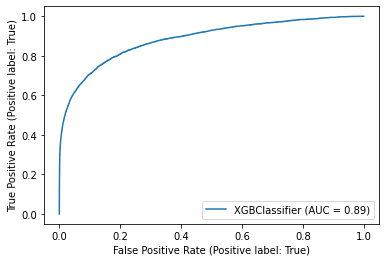


 PR curve : 



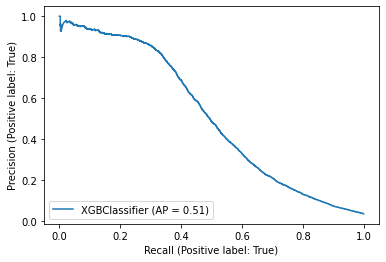

In [ ]:
compute_evaluation_metric(xgb, x_test, y_test, y_pred_xgb, y_prob_pred_xgb)

Hyperparameter Tuning

https://medium.com/@ali.soleymani.co/stop-using-grid-search-or-random-search-for-hyperparameter-tuning-c2468a2ff887

In [ ]:
model = Pipeline(steps=[
    #('imputer', KNNImputer(n_neighbors=9, weights="distance")),
    ('over', SMOTE(sampling_strategy=0.25)),
    # oversampling 1 one's: 4 zero's
    ('under', RandomUnderSampler(sampling_strategy=0.5)),
    # undersampling the 0's  
    ('xgb', XGBClassifier(random_state=5, tree_method="hist", learning_rate=0.3,
                          scale_pos_weight=10.7, n_jobs=-1))])
# https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html

model_performance = cross_val_score(model, x_train, y_train, scoring="f1", cv=5).mean()
model_performance

In [ ]:
params = {
    "xgb__reg_lambda": [5, 10, 15], # manually set
    "xgb__learning_rate": [0.01, 0.05, 0.1, 0.15],
    "xgb__max_sample_leaf": [10, 100, 100],
         }

gs = GridSearchCV(estimator=model, param_grid=params, scoring="f1", cv=5, verbose=0)
gs.fit(x_train, y_train)
print(gs.best_params_)

In [ ]:
model = Pipeline(steps=[
    #('imputer', KNNImputer(n_neighbors=9, weights="distance")),
    ('over', SMOTE(sampling_strategy=0.25)),
    # oversampling 1 one's: 4 zero's
    ('under', RandomUnderSampler(sampling_strategy=0.5)),
    # undersampling the 0's  
    ('xgb', XGBClassifier(# update with the params from above cell))])
# https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html

model_performance = cross_val_score(model, x_train, y_train, scoring="f1", cv=5).mean()
model_performance

In [ ]:
# https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
# https://scikit-learn.org/stable/modules/cross_validation.html

In [ ]:
model_performance = cross_val_score(model, x_train, y_train, scoring="f1", cv=5).mean()
model_performance

Feature Importance

Dave: plz put the code of the plot_importance() here

In [ ]:
model.fit(x_train, y_train)
plot_importance(model.named_steps["xgb"]) # Put the function above 
plt.show()

# ranking of the importance of variables (columns)
# <= 0.025 important score
# df.drop(columns=[cols that score below a certain point], inplace=True)

In [ ]:
imp = model.named_steps["xgb"].feature_importances_
imp

In [ ]:
feature_list = []

for i,j in enumerate(x_train.columns):
    feature_list.append([j, imp[i]])

feature_list = pd.DataFrame(feature_list, columns=["feature", "score"])
feature_list.sort_values(by="score", ascending=False, inplace=True)
feature_list

In [ ]:
to_drop = feature_list[feature_list["score"] <= 0.025] # keep those scoring > 0.025

In [ ]:
# drop the columns from above
# df.drop(columns=to_drop, inplace=True)

https://scikit-learn.org/stable/auto_examples/model_selection/plot_learning_curve.html
